# Audio Effect DSP
I have recreated some standard DAW audio effects from scratch using digital signal processing in Python

## Setup

In [2]:
import IPython.display as ipd
import numpy as np
import librosa as lbr
import matplotlib.pyplot as plt
import math

In [3]:
# name of audio file to import
src = "b.wav"

# imports audio file
# x: audio time series data, sr: sample rate
x, sr = lbr.load(src, sr=None)

# show imported data
print(x)
display(ipd.Audio(x, rate=sr))

# used to give input values... TODO 
def rangeify(lo, hi, value):
    value = max(0, min(value, 1))
    return (lo + ((hi-lo)*value))

# normalises audio
def normalise(a):
    return a / np.max(np.abs(a))

# incorporates new audio into original by a given amount
def combine(original, new, intensity):
    final = (1-intensity)*normalise(original) + intensity*normalise(new)
    return normalise(final)

[ 0.0000000e+00 -1.1920929e-07 -1.7881393e-07 ... -5.7495832e-03
 -5.4029822e-03 -9.5479488e-03]


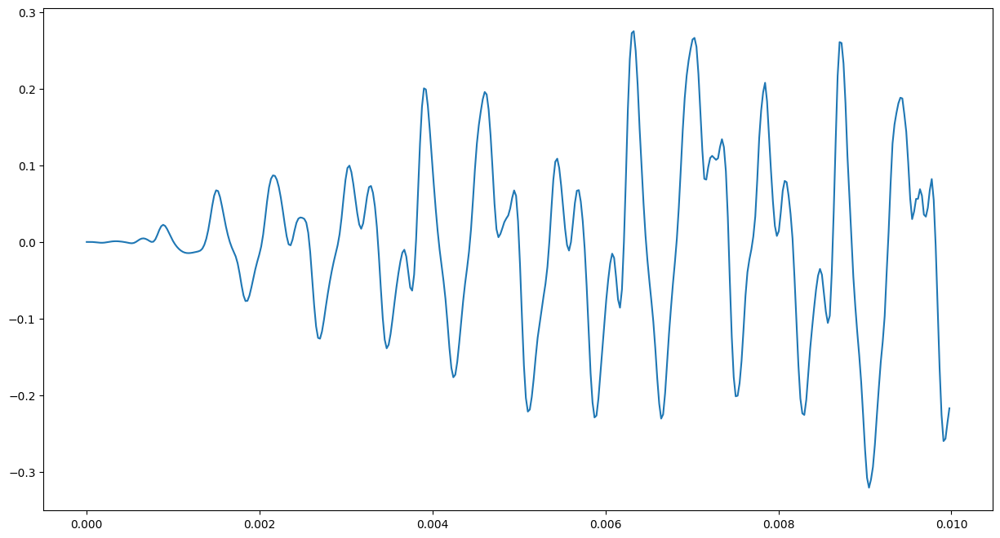

In [4]:
# plots an amplitude/time graph to compare original and new audio
def showDifference(items, sr, seconds=0.01):
    interval = 1/sr
    length = min( min([len(item) for item in items]), int(seconds*sr) )
    time = [interval * i for i in range(length)]
    plt.figure(figsize=(15,8))
    for item in items:
        plt.plot(time, item[:len(time)])
    plt.show()

# plot imported audio data
showDifference([x], sr)

## Bitcrusher
A distortion effect that reduces the perceived sound quality

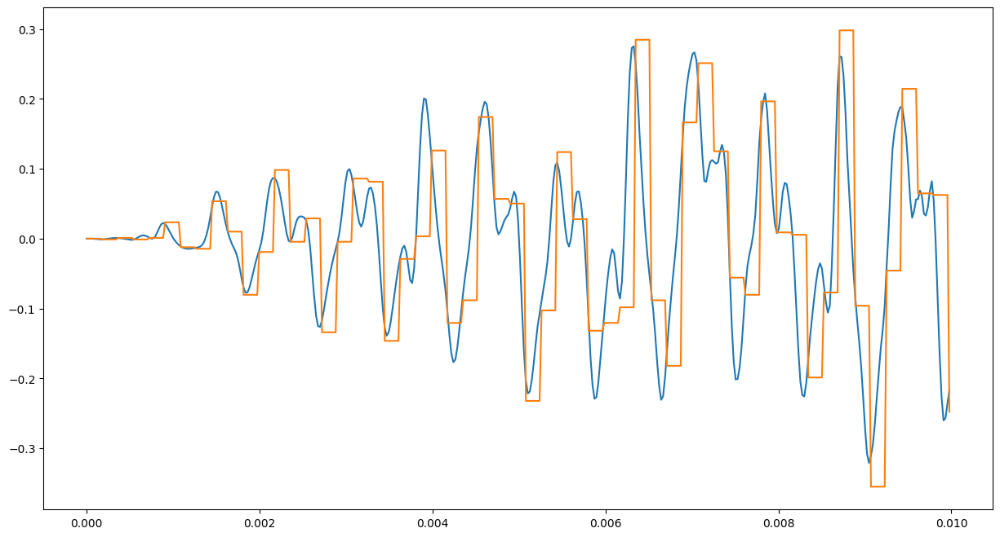

In [8]:
# q: determines block size of the quantisation effect (increasing q decreases perceived quality)
# r: determines new bit depth
def bitcrusher(a, sr, q, r, intensity):
    # quantises audio to reduce perceived sound quality
    def quantise(a, sr, block):
        if block == 0: return a
        prev = 0
        for i in range(len(a)):
            if i%block == 0:
                prev = a[i]
            else:
                a[i] = prev
        return a
    
    # reduce perceived resolution by reducing bit depth
    def reduceRes(a, sr, depth):
        max_value = 2**depth - 1
        return np.round(a * max_value) / max_value
   
    blockSize = int(rangeify(0, 16, q))
    y = quantise(a.copy(), sr, blockSize)

    bitDepth = rangeify(3,10,r)
    y = reduceRes(y, sr, bitDepth)
    
    return combine(a, y, intensity)

x, sr = lbr.load(src, sr=None)
y = bitcrusher(x.copy(), sr, 0.5, 5, 1)
showDifference([x, y], sr)
display(ipd.Audio(y, rate=sr))

## Distortion
Adds a fuzzy or gritty tone

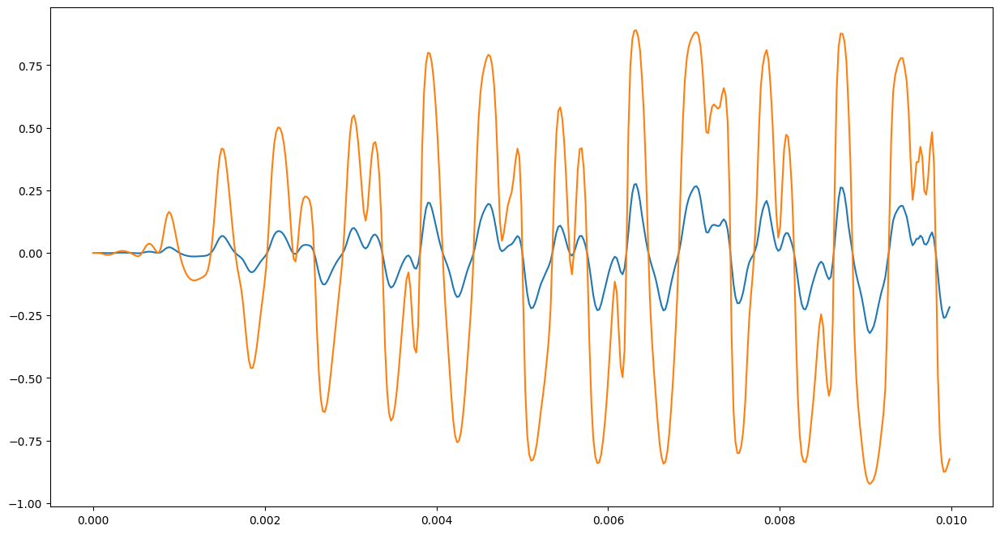

In [9]:
# g determines gain
def distortion(x, sr, g, intensity):
    # increases gain
    q = x*g

    # TODO function here
    y = np.sign(q)*(1-np.exp(-np.abs(q)))

    return combine(x, y, intensity)

x, sr = lbr.load(src, sr=None)
y = distortion(x.copy(), sr, 8, 1)
showDifference([x, y], sr)
display(ipd.Audio(y, rate=sr))

## Gain
Increase perceived loudness

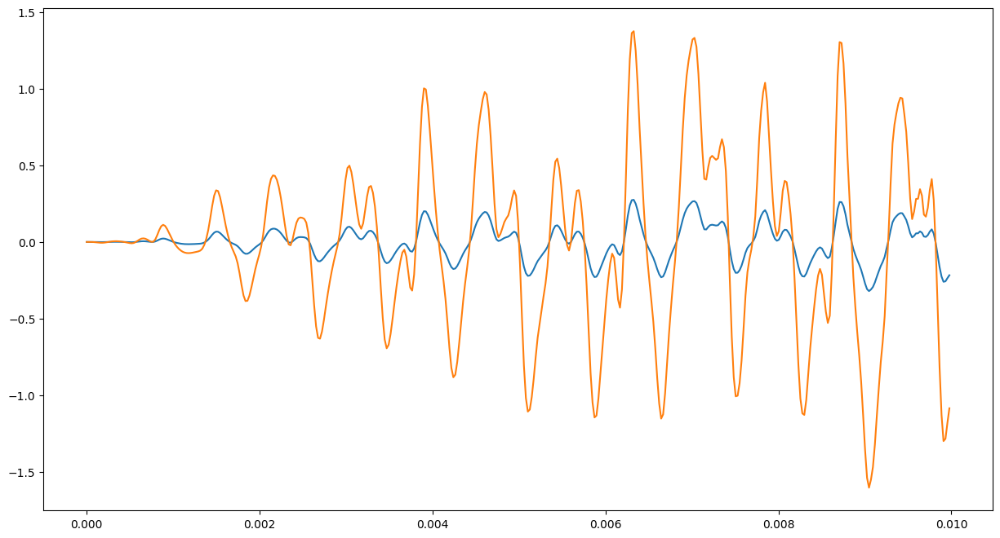

In [11]:
# increase amplitude of each sample by a factor
def gain(a, sr, g):
    return a*g

x, sr = lbr.load(src, sr=None)
y = gain(x, sr, 5)
showDifference([x, y], sr)
display(ipd.Audio(y, rate=sr))

## Reverse
Plays samples in reverse order

In [12]:
def reverse(a, sr):
    return a[::-1]

x, sr = lbr.load(src, sr=None)
z = reverse(x, sr)
display(ipd.Audio(z, rate=sr))

## Echo
Replays each sample at a given time

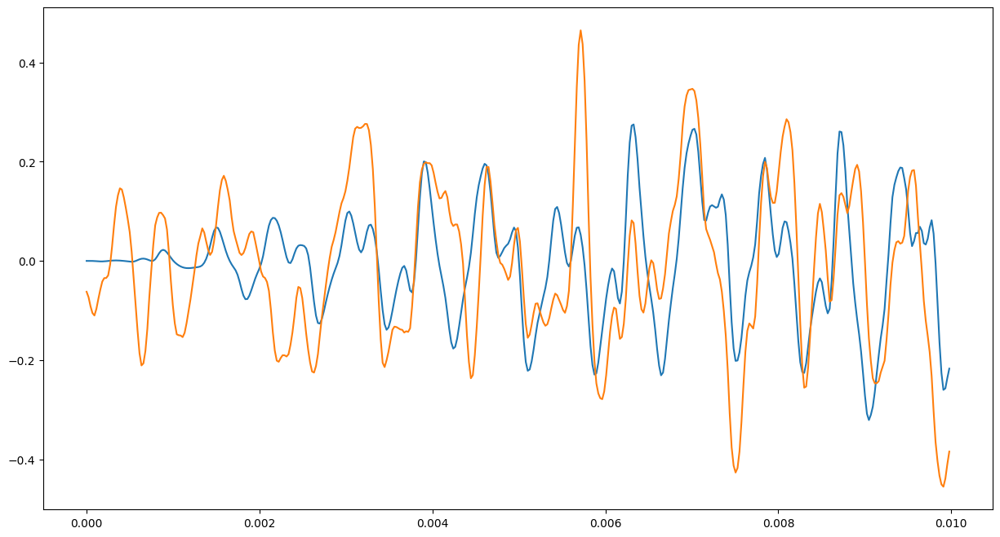

In [13]:
#d: delay time in seconds
#f: feedback level (0-1)
def echo(a, sr, d, f):
    # calculate number of samples after which each sample is replayed
    noSamples = int(d * sr)

    # create echoed signal
    y = np.concatenate((a[noSamples:], np.zeros(noSamples)))
    
    y = a + f * y    
    return normalise(y)

x, sr = lbr.load(src, sr=None)
y = echo(x, sr, 0.5, 1)
display(ipd.Audio(y, rate=sr))
showDifference([x,y], sr)

## Pitch shift
Alters the pitch

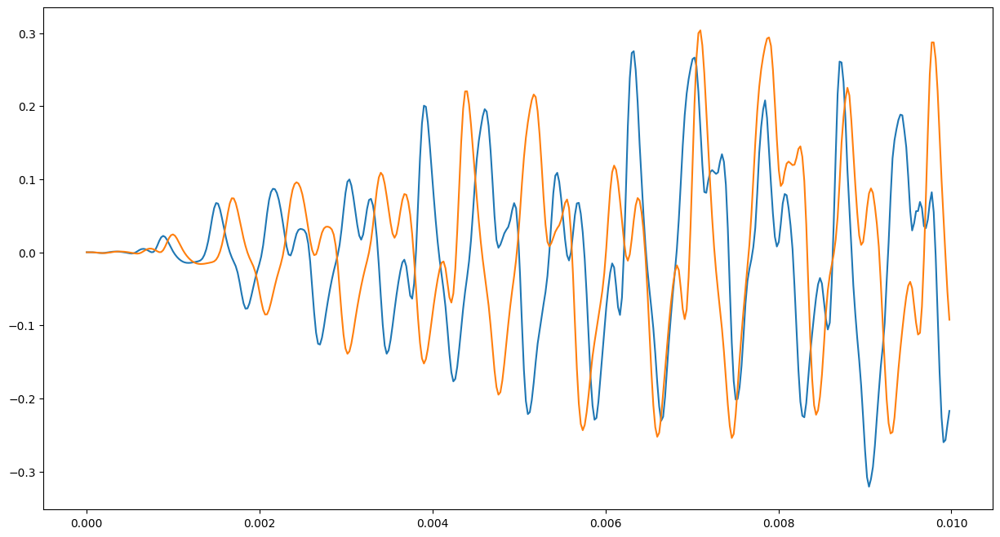

In [14]:
def pitchShift(a, sr, s):
    #s: no. semitones to shift

    # factor by which original audio should be multiplied to achieve pitch shift
    factor = 2 ** (s / 12)

    # TODO understand time axes
    # create time axis for original audio
    time_orig = np.arange(0, len(a)) / sr
    
    # create time axis for shifted audio
    time_shifted = np.arange(0, len(a)) * factor / sr
    
    # interpolate audio using the new time axis
    y = np.interp(time_shifted, time_orig, a)
        
    return normalise(y)

x, sr = lbr.load(src, sr=None)
y = pitchShift(x, sr, -2)
display(ipd.Audio(y, rate=sr))
showDifference([x,y], sr)

## Tremolo
Varies volume at a given rate by a given depth

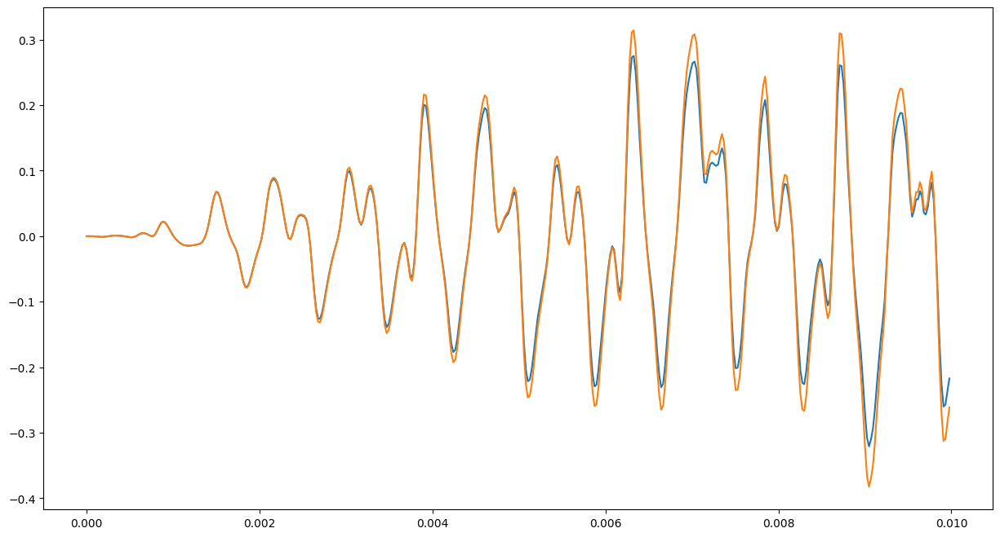

In [23]:
# rate: number of modulations per second
# depth: % decrease in volume for each modulation
def tremolo(a, sr, rate, depth, intensity):
    rate = rangeify(0.1, 20, rate)
    depth = rangeify(0, 1, depth)
    
    # create time array
    # time[i] is the time (in seconds) at which the ith sample is played
    time = np.arange(len(a)) / sr

    # create modulation signal
    # signal[i] is the factor by which the ith sample is multiplied to produce the tremolo effect
    signal = (1 + depth * np.sin(2 * np.pi * rate * time)) / 2

    # apply modulation
    y = combine(a, a * signal, intensity)
    
    return normalise(y)

x, sr = lbr.load(src, sr=None)
y = tremolo(x, sr, 1, 1, 1)
display(ipd.Audio(y, rate=sr))
showDifference([x,y], sr)